# Deliverables:

- Submit the following two files:

 1. Your **html document** that has your Source code and output
 2. Your **ipynb script** that has your Source code and output


# Objectives:

- Use SQL to execute different queries to retrieve data from Chicago Crime dataset and Police Station dataset
- Use Geospatial queries  to locate **police stations** and **gun** related crimes (with arrest or no arrest) in every district on **Choropleth** map
- Use Geospatial queries  to provide **descriptive stat** for every **district** on Choropleth map
- Use Geospatial queries  to locate the **Block** that is the furthest (Maximum Distance) from the police station that has gun related crime resulted in arrest.


# Submission Formats :

1. Complete IPYNB script that has the source code in Python used to access and analyze the data. The code should be submitted as an IPYNB script that can be be loaded and run in Jupyter Notebook for Python.
3. Make sure to include your name as part of the IPYNB file name.
2. From the File menu select Download As -> HTML (.html) to create an HTML of the IPYNB file.


Formatting Python Code
When programming in Python, refer to Kenneth Reitz’ PEP 8: The Style Guide for Python Code:
http://pep8.org/ (Links to an external site.)Links to an external site.
There is the Google style guide for Python at
https://google.github.io/styleguide/pyguide.html (Links to an external site.)Links to an external site.
Comment often and in detail.


# Descriptions and Requirement Specifications

## Chicago Crimes

In his first state of the uniion address , president Trump mentioned Chicago violence 10 times __[Trump's State of the Union Address](http://www.chicagotribune.com/news/local/breaking/ct-trump-tweets-quotes-chicago-htmlstory.html)__ 

## Chicago  has more homicides than New York and Los Angeles combined

Columnist Clarence Page wrote an   __[article](http://www.chicagotribune.com/news/opinion/page/ct-perspec-page-trump-murder-rate-jeff-sessions-0103-20180102-story.html)__ , published by the Chicago Tribune stated that the city of Chicago had **more homicides in the past two years than New York and Los Angeles combined**

# Chicago Police Department

Chicago police department  __[CPD](https://home.chicagopolice.org/community/districts/11th-district-harrison/)__  issues and publishes on daily basis on its website crime alerts, and press releases for the different __[districts](https://home.chicagopolice.org/community/districts/)__ .

# Chicago Crimes Dataset

The CSV file for crimes dataset for  the city of Chicago is obtained from the data portal for the city of Chicago. Here is the link for the city of Chicago data portal __[City of Chicago Data Portal](https://data.cityofchicago.org/Public-Safety/Crimes-2001-to-present/ijzp-q8t2)__ 


### Loading the Dataset CSV file

Three datasets are need for this assignment:
1. The Chicago police stations in every district
2. The Boundaries.geojson data for district boundaries
3. The Crimes dataset 


Lets load the CSV file into a DataFrame object and see the nature of the data that we have.

Complete description of the dataset can be found on Chicago city data portal.

Based on Trumps State of the Union Address and the article written by  columnist Clarence Page and  published by the Chicago Tribune, we are interested to retrieve the data for the past two years and perform different types of spatial queries.

There are few of these queries that we are interested in to help CPD and city of Chicago to plot on a Choropleteh map those districts that have highest gun crimes. 

Here are examples of those types of queries:

1. Plot on **Choropleth map** the **districts** and their **Violent Crimes**
2. Plot on Choropleth map the districts and their **Gun** related crimes
3. Which district is the **crime capital** of **Chicago districts**?
4. What the **crime density** per **district**?
5. Plot on Choropleth map those **gun related crimes** that resulted in **arrests**
5. Plot on Choropleth map the gun related crime that is in the **farthest Block**  from the **policy station** for every **district**  




Packages you need to Connect **PostgreSQL** server to load and retrieve Crhicago Crime dataset from the database:

1. **psycopg2:** for PostgreSQL driver
2. **area:** to calculate the area inside of any GeoJSON geometry
3. **Folium:** for Choropleth maps


Since we are using PostGIS in our work, please read and bookmark __[Chapter 4. Using PostGIS: Data Management and Queries](https://postgis.net/docs/manual-1.4/ch04.html)__ 


In [ ]:
#!pip install psycopg2

Collecting psycopg2
  Downloading https://files.pythonhosted.org/packages/5c/1c/6997288da181277a0c29bc39a5f9143ff20b8c99f2a7d059cfb55163e165/psycopg2-2.8.3.tar.gz (377kB)
    100% |████████████████████████████████| 378kB 6.6MB/s eta 0:00:01
Building wheels for collected packages: psycopg2
  Building wheel for psycopg2 (setup.py) ... done
  Stored in directory: /Users/EdwardArroyo/Library/Caches/pip/wheels/48/06/67/475967017d99b988421b87bf7ee5fad0dad789dc349561786b
Successfully built psycopg2
Installing collected packages: psycopg2
Successfully installed psycopg2-2.8.3

In [ ]:
#!pip install area

In [ ]:
#!pip install folium

In [1]:
import folium
from folium import plugins
from folium.plugins import MarkerCluster
import psycopg2
import csv
import pandas as pd
import json
from area import area

from psycopg2.extensions import ISOLATION_LEVEL_AUTOCOMMIT 


In [2]:
# connect to VPN before running remainder of notebook!
# https://canvas.northwestern.edu/courses/101738/assignments/615261

In [ ]:
import getpass

pw = getpass.getpass("Password: ")
print(pw)

In [3]:
# def reset():
db_connection = psycopg2.connect(host='129.105.208.229',dbname="chicago_crimes", user="clb7416" , password=pw)


cursor = db_connection.cursor()

In [4]:
db_connection.commit()

### Chicago Crimes Dataset

The Crimes_2001_to_present.csv is downloaded from Chicago data portal and it has roughly 6.5 million records.

While working on this dataset, It is prudent to make a note of the following:
1. Geospatial  queries are very demanding for system resources like CPU, Memory, and DISK
1. We are interested in the data set of the past 2 years, and when you execute Geospatial type queries, please be advised that these queries slow down your machine. 
2. Running this script to work on the data of the past 2 years will require roughly 25 minutes to complete. And requires roughly 40 minutes to complete using the dataset of the past 5 years. And requires hours to complete on the entire dataset with at least 16GB memory.
3. It is a good idea to take a slice (past two years) of the dataset and store it, that will help improve performance significantly specially for SEARCH and SORT algorithms that are utilized by the database engine.


### Algorithm Performance

- **Sort algorithms** used by the database engines vary in performance between O($N log N$) and O($ N^{2} $) where $N$ is the size of the number

- **Search algorithms** used by the database engines vary in performance between O($log N$) and O($ N $) where $N$ is the size of the number




## Lets start executing different  Queries

## Query #1:
- Calculate the total number of **crimes** in every district and plot that on Choropleth map. In other words, create a Choropleth map where the districts are shaded in proportion to the number of **crimes** in that district.

In [6]:
cursor.execute("SELECT district, count(district) from crimes GROUP BY district")
rows=cursor.fetchall()

In [7]:
crimes_per_district = pd.DataFrame(rows, columns=['dist_num','number_of_crimes'])
crimes_per_district['dist_num'] = crimes_per_district['dist_num'].astype(str)

crimes_per_district.head()

,dist_num,number_of_crimes
0,1,31994
1,2,25160
2,3,27306
3,4,32434
4,5,25618


In [8]:
crimes_per_district_map = folium.Map(location =(41.8781, -87.6298),zoom_start=11)

In [ ]:
## This will yield a warning about choropleth being deprecated in future version...
# crimes_per_district_map.choropleth(geo_data="Boundaries.geojson", 
#               fill_color='OrRd', 
#               fill_opacity=0.5, 
#               line_opacity=1,
#               data = crimes_per_district,
#               key_on='feature.properties.dist_num',
#               columns = ['dist_num', 'number_of_crimes'],
#               legend_name="CRIME MAP"
#               )

# I pasted a screenshot of this warning in the next (markdown cell)

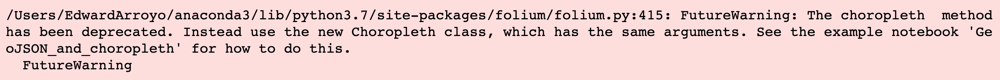

In [9]:
## Use this this instead of the code in last cell. Note "choropleth" is now "Choropletth".
folium.Choropleth(geo_data="Boundaries.geojson", 
              fill_color='OrRd', 
              fill_opacity=0.5, 
              line_opacity=1,
              data = crimes_per_district,
              key_on='feature.properties.dist_num',
              columns = ['dist_num', 'number_of_crimes'],
              legend_name="CRIMES PER DISTRICT"
              ).add_to(crimes_per_district_map)
crimes_per_district_map

In [10]:
cursor.execute("""SELECT ST_X(ST_AsText(Where_IS)), ST_Y(ST_AsText(Where_IS)), district from police_stations where district!='Headquarters'""")
police_stations = cursor.fetchall()

for police_station in police_stations:
    police_station_location = (police_station[0],police_station[1])
    cursor.execute('''
        SELECT district, count(district) 
        FROM crimes 
        WHERE district= %s 
        GROUP BY district
    ''',[police_station[2]])
    districts_crime_numbers = cursor.fetchall()
    #print(districts_crime_numbers)
    for district in districts_crime_numbers:
        folium.Marker(location = 
                      police_station_location,
                      popup=folium.Popup(
                          html="District No : %s  has   Total Number of Crimes:%s" %district ,max_width=450)).add_to(crimes_per_district_map)


- **Lets plot the Choropleth map and notice  the intensity of color on the different districts**
- **The Blue POPUP represents the location of police station in the different districts in the map**

In [19]:
#  db_connection.commit()

In [11]:
crimes_per_district_map

## Query #2:

* Calculate the total number of **violent crimes** in every district and plot that in a **table** on Choropleth map. In other words, create a Choropleth map where the districts are shaded in proportion to the number of **violent crimes** in that district. 

**N.B**: A crime is considered a **violent crime** if the **PRIMARY_TYPE** of the crimes is  `THEFT` ,`ASSAULT`,`ROBBER`,`KIDNAPPING`,`CRIM SEXUAL ASSAULT`,`BATTERY`, or `MURDER`.

* Then find the total number of crimes in the district for each of these primary types of violent crime and add a popup marker (located at that district's police headquarter) that displays a DataFrame containing this data.

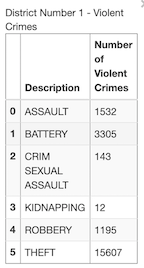

In [12]:
db_connection.commit()

In [13]:
violent_crime_categories='THEFT','ASSAULT','ROBBERY','KIDNAPPING','CRIM SEXUAL ASSAULT','BATTERY','MURDER'

In [14]:
# create overlay, original code
cursor.execute('''
    SELECT district, count(district) 
    FROM crimes 
    WHERE PRIMARY_TYPE in %s 
    GROUP BY district
''',[violent_crime_categories])
rows=cursor.fetchall()
violent_crimes_per_district=pd.DataFrame(rows, columns=['dist_num','number_of_violent_crimes'])
violent_crimes_per_district['dist_num'] = violent_crimes_per_district['dist_num'].astype(str)
violent_crimes_per_district

,dist_num,number_of_violent_crimes
0,1,21794
1,2,14517
2,3,14988
3,4,17128
4,5,13112
5,6,19772
6,7,15931
7,8,18530
8,9,14030
9,10,13988


In [15]:
# using f-string formatting
cursor.execute(f'''
    SELECT district, count(district) 
    FROM crimes 
    WHERE PRIMARY_TYPE in {violent_crime_categories}
    GROUP BY district
''')
rows=cursor.fetchall()
violent_crimes_per_district=pd.DataFrame(rows, columns=['dist_num','number_of_violent_crimes'])
violent_crimes_per_district['dist_num'] = violent_crimes_per_district['dist_num'].astype(str)
violent_crimes_per_district

,dist_num,number_of_violent_crimes
0,1,21794
1,2,14517
2,3,14988
3,4,17128
4,5,13112
5,6,19772
6,7,15931
7,8,18530
8,9,14030
9,10,13988


In [ ]:
# violent_crimes_per_district_map= folium.Map(location =(41.8781, -87.6298),zoom_start=11)
# violent_crimes_per_district_map.choropleth(geo_data="Boundaries.geojson", 
#               fill_color='YlOrRd', 
#               fill_opacity=0.5, 
#               line_opacity=1,
#               data = violent_crime_per_district,
#               key_on='feature.properties.dist_num',
#               columns = ['district_num', 'number_of_violent_crimes'],
#               legend_name="VOILENT CRIME MAP"
#               )


In [16]:
# base map
violent_crimes_per_district_map= folium.Map(location =(41.8781, -87.6298),zoom_start=11)
# overlay
folium.Choropleth(geo_data="Boundaries.geojson", 
              fill_color='OrRd', 
              fill_opacity=0.5, 
              line_opacity=1,
              data = violent_crimes_per_district,
              key_on='feature.properties.dist_num',
              columns = ['dist_num', 'number_of_violent_crimes'],
              legend_name="VIOLENT CRIMES PER DISTRICT"
              ).add_to(violent_crimes_per_district_map)
violent_crimes_per_district_map

In addition, for each district find the block(s) that has the highest number of gun crimes in that district. Note that there might be a tie for the highest number of gun crimes. You need to find **all** such blocks. Add a popup marker (located at that district's police headquarter) that displays a DataFrame containing all such block along with the number of gun crimes for that block (i.e. the highest number of crimes for a district).

In [17]:
cursor.execute("""SELECT ST_X(ST_AsText(Where_IS)), ST_Y(ST_AsText(Where_IS)), district from police_stations where district!='Headquarters'""")
police_stations = cursor.fetchall()

for police_station in police_stations:
    police_station_location =(police_station[0],police_station[1])
    cursor.execute('''
        SELECT PRIMARY_TYPE, count(PRIMARY_TYPE) 
        FROM crimes 
        WHERE district =%s AND PRIMARY_TYPE in %s 
        GROUP BY PRIMARY_TYPE
    ''',[police_station[2],violent_crime_categories])
    data = cursor.fetchall()
#     print(data)
    violent_crimes_per_district = pd.DataFrame(data, columns=['Description', 'Number of Violent Crimes'])
    # to add header to popup marker: dataframe to html
    header = violent_crimes_per_district.to_html(classes='table table-striped table-hover table-condensed table-responsive')
    folium.Marker(location=police_station_location, popup=folium.Popup(html="District Number %s - Violent Crimes %s" %(police_station[2],header))).add_to(violent_crimes_per_district_map)



In [ ]:
# db_connection.commit()

In [18]:
violent_crimes_per_district_map

## Query #3:
- Calculate the total number of **gun related violent crimes** in every district and plot that in a table on Choropleth map.

**N.B**: A crime is considered a **gun related violent crime** if the word "gun" is contained in the **DESCRIPTION** and the **PRIMARY_TYPE** of the crimes is  `THEFT` ,`ASSAULT`,`ROBBER`,`KIDNAPPING`,`CRIM SEXUAL ASSAULT`,`BATTERY`, or `MURDER`.

* Then find the total number of crimes in the district for the different DESCRIPTIONs containing the word "gun" and add a popup marker (located at that district's police headquarter) that displays a DataFrame containing this data.


Lets first create a dataframe of **violent gun crimes per district**.


In [19]:
db_connection.commit()

In [20]:
# original
# Description has "GUN" in it
# query gets description of matching crimes in that district
# with certain description, certain type
gun='%GUN%'
cursor.execute('''
    SELECT district, count(district) 
    FROM crimes 
    WHERE DESCRIPTION::text LIKE %s and PRIMARY_TYPE in %s 
    GROUP BY district
''',[gun,violent_crime_categories])
rows = cursor.fetchall()
violent_gun_crimes_per_district = pd.DataFrame(rows, columns=['dist_num','number_of_violent_gun_crimes'])
violent_gun_crimes_per_district['dist_num'] = violent_gun_crimes_per_district['dist_num'].astype(str)
violent_gun_crimes_per_district

,dist_num,number_of_violent_gun_crimes
0,1,354
1,2,1101
2,3,1454
3,4,1351
4,5,1225
5,6,1837
6,7,1646
7,8,1476
8,9,1335
9,10,1426


In [21]:
# f-string formatting
# query gets description of matching crimes in that district
# with certain description, certain type
# add quotes for query to treat as text pattern, % is for wildcard at front and end
gun="'%GUN%'"
cursor.execute(f'''
    SELECT district, count(district) 
    FROM crimes WHERE DESCRIPTION::text LIKE {gun} and PRIMARY_TYPE in {violent_crime_categories} 
    GROUP BY district''')
rows = cursor.fetchall()
violent_gun_crimes_per_district = pd.DataFrame(rows, columns=['dist_num','number_of_violent_gun_crimes'])
violent_gun_crimes_per_district['dist_num'] = violent_gun_crimes_per_district['dist_num'].astype(str)
violent_gun_crimes_per_district

,dist_num,number_of_violent_gun_crimes
0,1,354
1,2,1101
2,3,1454
3,4,1351
4,5,1225
5,6,1837
6,7,1646
7,8,1476
8,9,1335
9,10,1426


In [ ]:
# violent_gun_crimes_per_district_map= folium.Map(location =(41.8781, -87.6298),zoom_start=11)
# violent_gun_crimes_per_district_map.choropleth(geo_data="Boundaries.geojson", 
#               fill_color='YlOrRd', 
#               fill_opacity=0.5, 
#               line_opacity=1,
#               data = violent_gun_crimes_per_district,
#               key_on='feature.properties.dist_num',
#               columns = ['dist_num', 'number_of_violent_gun_crimes'],
#               legend_name="VIOLENT GUN CRIMES PER DISTRICT"
#               )


In [22]:
violent_gun_crimes_per_district_map= folium.Map(location =(41.8781, -87.6298),zoom_start=11)
folium.Choropleth(geo_data="Boundaries.geojson", 
              fill_color='OrRd', 
              fill_opacity=0.5, 
              line_opacity=1,
              data = violent_gun_crimes_per_district,
              key_on='feature.properties.dist_num',
              columns = ['dist_num', 'number_of_violent_gun_crimes'],
              legend_name="VIOLENT GUN CRIMES PER DISTRICT"
              ).add_to(violent_gun_crimes_per_district_map)
violent_gun_crimes_per_district_map

Now, lets create a dataframe of the **different types of violent gun crimes for every district** and then plot it on Choropleth map

In [23]:
# f-string formatting
cursor.execute("""SELECT ST_X(ST_AsText(Where_IS)), ST_Y(ST_AsText(Where_IS)), district from police_stations where district!='Headquarters'""")

gun="'%GUN%'"
police_stations = cursor.fetchall()

# returning x and y coordinate from police_stations
# rewrite as for station in police_stations (use station as iterator)
for station in police_stations:
    police_station_location = (station[0],station[1])
    cursor.execute(f'''
        SELECT DESCRIPTION, count(DESCRIPTION) 
        FROM crimes 
        WHERE district = {station[2]} and DESCRIPTION::text LIKE {gun} and PRIMARY_TYPE in {violent_crime_categories}
        GROUP BY DESCRIPTION
    ''')
    data=cursor.fetchall()
    df = pd.DataFrame(data, columns=['Description', 'Number of Violent Gun Crimes'])
    header = df.to_html(classes='table table-striped table-hover table-condensed table-responsive')
    #folium.Marker(location=police_station_location,popup=folium.Popup(html="District No: %s GUN_Crime: %s" %(police_station[2],header) )).add_to(violent_gun_crimes_per_district_map)
    # f string formatting
    folium.Marker(location=police_station_location,popup=folium.Popup(html=f"District No: {police_station[2]} GUN_Crime: {header}"  )).add_to(violent_gun_crimes_per_district_map)
    

In [96]:
# original
cursor.execute("""SELECT ST_X(ST_AsText(Where_IS)), ST_Y(ST_AsText(Where_IS)), district from police_stations where district!='Headquarters'""")

gun='%GUN%'
police_stations = cursor.fetchall()

# returning x and y coordinate from police_stations
# rewrite as for station in police_stations (use station as iterator)
for police_station in police_stations:
    police_station_location = (police_station[0],police_station[1])
    cursor.execute('''
        SELECT DESCRIPTION, count(DESCRIPTION) 
        FROM crimes 
        WHERE district=%s and DESCRIPTION::text LIKE %s and PRIMARY_TYPE in %s 
        GROUP BY DESCRIPTION
    ''',[police_station[2],gun, violent_crime_categories])
    data=cursor.fetchall()
    df = pd.DataFrame(data, columns=['Description', 'Number of Violent Gun Crimes'])
    header = df.to_html(classes='table table-striped table-hover table-condensed table-responsive')
    folium.Marker(location=police_station_location,popup=folium.Popup(html="District No: %s GUN_Crime: %s" %(police_station[2],header) )).add_to(violent_gun_crimes_per_district_map)
    


In [19]:
#  db_connection.commit()

In [24]:
violent_gun_crimes_per_district_map

## Query #4:
- Calculate the crime density per district

In [25]:
district=[]
tarea=[]

# closes automatically after reaching end of block
with open('Boundaries.geojson') as f:
    data = json.load(f)
    a = data['features'] # a is a list of district data (dictionaries)
    for i in range(len(a)):# a[i] is the dictionary for ith district in Boundaries.geojson
        obj=a[i]['geometry'] # list of coordinates for ith district
        n= a[i]['properties'] # district number and district label for ith district
        district.append(n['dist_num']) # add district number to the district list
        # 1 square meter = 1/10000 hectares. area(obj) is in hectares
        tarea.append(area(obj)/10000) # add the area (in hectares) to area list
        
af = pd.DataFrame({'dist_num': district,'district_area_in_Hectares':tarea})
af['dist_num'] = af['dist_num'].astype(str)
final_data = pd.merge(af, crimes_per_district, on = 'dist_num', how = 'inner')
final_data['crime_density'] = round(final_data['number_of_crimes']/(final_data['district_area_in_Hectares']/100))
final_data

,dist_num,district_area_in_Hectares,number_of_crimes,crime_density
0,17,2492.727155,17165,689.0
1,20,1132.170216,9820,867.0
2,31,51.045317,16,31.0
3,31,799.507694,16,2.0
4,31,32.407658,16,49.0
5,19,2225.035732,26135,1175.0
6,25,2827.989237,31477,1113.0
7,14,1555.869965,21793,1401.0
8,7,1688.670732,30748,1821.0
9,3,1576.063931,27306,1733.0


## Query #5:
- Create **Marker Clusters** on Choropleth map for those **gun related violent crimes** that resulted in **arrest (green icon)** and those that **didn't (red icon)**.

In [ ]:
# gun_crime_arrests_map = folium.Map(location =(41.8781, -87.6298),zoom_start=11)
# gun_crime_arrests_map.choropleth(geo_data="Boundaries.geojson", 
#               fill_color='YlOrRd', 
#               fill_opacity=0.5, 
#               line_opacity=1,
#               data = violent_gun_crimes_per_district,
#               key_on='feature.properties.dist_num',
#               columns = ['dist_num', 'number_of_violent_gun_crimes'],
#               legend_name="GUN CRIME"
#               )


In [26]:
gun_crime_arrests_map = folium.Map(location =(41.8781, -87.6298),zoom_start=11)
folium.Choropleth(geo_data="Boundaries.geojson", 
              fill_color='OrRd', 
              fill_opacity=0.5, 
              line_opacity=1,
              data = violent_gun_crimes_per_district,
              key_on='feature.properties.dist_num',
              columns = ['dist_num', 'number_of_violent_gun_crimes'],
              legend_name="VIOLENT GUN CRIMES PER DISTRICT"
              ).add_to(gun_crime_arrests_map)
gun_crime_arrests_map

In [60]:
# original
cursor.execute("""SELECT ST_X(ST_AsText(Where_IS)), ST_Y(ST_AsText(Where_IS)), district from police_stations where district!='Headquarters'""")
gun='%GUN%'

police_stations = cursor.fetchall()

marker_cluster = MarkerCluster().add_to(gun_crime_arrests_map)

for police_station in police_stations:
    police_station_location = (police_station[0],police_station[1])
    cursor.execute('''
    
        SELECT DISTINCT ON(caseno) 
            caseno, block,DESCRIPTION, count(arrest), arrest,latitude, longitude 
        FROM crimes 
        WHERE district=%s and DESCRIPTION::text LIKE %s GROUP BY caseno,block, 
              DESCRIPTION, arrest, latitude, longitude
    
    ''',[police_station[2],gun])
    crimes_per_district = cursor.fetchall()
    for crime in crimes_per_district:
        if crime[4]==True:
            folium.Marker(location=(crime[5],crime[6]),popup=folium.Popup(html="District No: %s <br> Description: %s <br> Block: %s" %(police_station[2],crime[2],crime[1])),icon=folium.Icon(color='green', icon='ok-sign'),).add_to(marker_cluster)
        else:
            folium.Marker(location=(crime[5],crime[6]),popup=folium.Popup(html="District No: %s <br> Description: %s<br> Block: %s" %(police_station[2],crime[2],crime[1])),icon=folium.Icon(color='red', icon='remove-sign'),).add_to(marker_cluster)


In [70]:
# f-string formatting
cursor.execute("""SELECT ST_X(ST_AsText(Where_IS)), ST_Y(ST_AsText(Where_IS)), district from police_stations where district!='Headquarters'""")
gun = "'%GUN%'"

police_stations = cursor.fetchall()

marker_cluster = MarkerCluster().add_to(gun_crime_arrests_map)

for station in police_stations[:1]:
    police_station_location = (station[0],station[1])
    cursor.execute(f'''
    
        SELECT DISTINCT ON(caseno) 
            caseno, block,DESCRIPTION, count(arrest), arrest,latitude, longitude 
        FROM crimes 
        WHERE district = {station[2]} and DESCRIPTION::text LIKE {gun} GROUP BY caseno,block, 
              DESCRIPTION, arrest, latitude, longitude
    
    ''')
    crimes_per_district = cursor.fetchall()
    for crime in crimes_per_district:
        if crime[4]==True:
#             folium.Marker(location=(crime[5],crime[6]),popup=folium.Popup(html="District No: %s <br> Description: %s <br> Block: %s" %(police_station[2],crime[2],crime[1])),icon=folium.Icon(color='green', icon='ok-sign'),).add_to(marker_cluster)
            folium.Marker(location=(crime[5],crime[6]),popup=folium.Popup(html=f"District No: {station[2]} <br> Description: {crime[2]} <br> Block: {crime[1]}"  ),icon=folium.Icon(color='green', icon='ok-sign'),).add_to(marker_cluster)
        else:
            #folium.Marker(location=(crime[5],crime[6]),popup=folium.Popup(html="District No: %s <br> Description: %s<br> Block: %s" %(police_station[2],crime[2],crime[1])),icon=folium.Icon(color='red', icon='remove-sign'),).add_to(marker_cluster)
            folium.Marker(location=(crime[5],crime[6]),popup=folium.Popup(html=f"District No: {station[2]} <br> Description: {crime[2]} <br> Block: {crime[1]}"  ),icon=folium.Icon(color='red', icon='remove-sign'),).add_to(marker_cluster)


In [28]:
def embed_map(m):
    from IPython.display import IFrame

    m.save('index.html')
    return IFrame('index.html', width='100%', height='750px')

In [29]:
embed_map(gun_crime_arrests_map)

## Query #6:
- Plot on Choropleth map the **farthest Block** that has a gun crime from every police station in every district 


Locate the **farthest** gun crime from the police station in every district. Create a Choropleth map where the districts are shaded in proportion to the number of ** gun crimes in that district. For each district, find the gun crime that was **farthest** from police station. Add a pop-up on the Choropleth map to display the district number and the Block where the **farthest** gun crime occurred. Also add circle marker (of radius 5) at the location of the **farthest** gun crime.

In [31]:
db_connection.commit()

In [32]:
# count of crimes per district

gun="'%GUN%'"

cursor.execute(f'''

    SELECT district, count(district) 
    FROM crimes 
    WHERE DESCRIPTION::text LIKE {gun}
    GROUP BY district

''')
rows=cursor.fetchall()
gun_crimes_per_district = pd.DataFrame(rows, columns=['dist_num','number_of_gun_crimes'])
gun_crimes_per_district['dist_num'] = gun_crimes_per_district['dist_num'].astype(str)

gun_crimes_per_district.head()

,dist_num,number_of_gun_crimes
0,1,410
1,2,1348
2,3,1928
3,4,1960
4,5,1925


In [11]:
# farthest_block_gun_crime_map = folium.Map(location =(41.8781, -87.6298),zoom_start=11)
# farthest_block_gun_crime_map.choropleth(geo_data="Boundaries.geojson", 
#               fill_color='YlOrRd', 
#               fill_opacity=0.5, 
#               line_opacity=1,
#               data = gun_crimes_per_district,
#               key_on='feature.properties.dist_num',
#               columns = ['dist_num', 'number_of_gun_crimes'],
#               legend_name="GUN CRIMES PER DISTRICT"
#               )
# farthest_block_gun_crime_map

In [33]:
# original map of gun crimes by district

farthest_block_gun_crime_map = folium.Map(location =(41.8781, -87.6298),zoom_start=11)
folium.Choropleth(geo_data="Boundaries.geojson", 
              fill_color='OrRd', 
              fill_opacity=0.5, 
              line_opacity=1,
              data = gun_crimes_per_district,
              key_on='feature.properties.dist_num',
              columns = ['dist_num', 'number_of_gun_crimes'],
              legend_name="GUN CRIMES PER DISTRICT"
              ).add_to(farthest_block_gun_crime_map )
farthest_block_gun_crime_map 

In [34]:
# original
cursor.execute("""SELECT DISTINCT ST_X(ST_AsText(Where_IS)), ST_Y(ST_AsText(Where_IS)), district from police_stations where district!='Headquarters'""")
police_stations = cursor.fetchall()

gun = '%GUN%'

# A = crimes table, containg block column
# B = stations table, using location info for district station
for police_station in police_stations:
    
    cursor.execute("""SELECT DISTINCT on (A.block) A.district, A.block, A.where_is, 
                                                   ST_Distance(A.where_is,B.where_is) 
                       FROM crimes as A, police_stations as B 
                       WHERE 
                             A.district=%s and DESCRIPTION::text LIKE %s and B.district= %s
                             and ST_Distance(A.where_is,B.where_is)
                       IN 
    
    ( SELECT max(dist) 
      FROM 
         (SELECT ST_Distance(A.where_is,B.where_is) as dist 
          FROM crimes as A, police_stations as B 
          WHERE A.district=%s  and DESCRIPTION::text LIKE %s and B.district= %s ) as f) 
       

    
    """,[police_station[2],gun,police_station[2],police_station[2],gun, police_station[2]])
    
    
    farthest_block_gun_crime = cursor.fetchall()
    
#     print(farthest_block_gun_crime)
#     print((farthest_block_gun_crime[0][2],farthest_block_gun_crime[0][2]))
    
    if not farthest_block_gun_crime: 
        continue
    
    cursor.execute('''
    SELECT ST_X(ST_AsText(%s)), ST_Y(ST_AsText(%s))
    ''',(farthest_block_gun_crime[0][2],farthest_block_gun_crime[0][2]))
    
    farthest_block_gun_crime_location = cursor.fetchall()
                   
    folium.Marker(location=(police_station[0],police_station[1]),popup=folium.Popup(html="Police Station <br> District No.:%s <br> Farthest Gun_Crime Block:%s"%(farthest_block_gun_crime[0][0],farthest_block_gun_crime[0][1]))).add_to(farthest_block_gun_crime_map)
    folium.CircleMarker(farthest_block_gun_crime_location[0],radius=5,color='#ff3187',popup=folium.Popup(html="District No.:%s <br> Block:%s"%(farthest_block_gun_crime[0][0],farthest_block_gun_crime[0][1]))).add_to(farthest_block_gun_crime_map) 
    

In [35]:
farthest_block_gun_crime_map

In [58]:
db_connection.commit()

# Requirements



** The HTML document your are submitting along with this notebook file must have the source code and the output for the following  requirements **


### Requirement #1: 
- Locate the **Block(s)** that has the **highest number of gun crimes**. Create a Choropleth map where the districts are shaded in proportion to the number of **gun crimes** in that district. In addition, for each district find the block(s) that has the highest number of gun crimes in that district. Note that there might be a tie for the highest number of gun crimes. You need to find **all** such blocks. Add a popup marker (located at that district's police headquarter) that displays a DataFrame containing all such block along with the number of gun crimes for that block (i.e. the highest number of crimes for a district).

In [37]:
# create map
highest_gun_crime_map = folium.Map(location =(41.8781, -87.6298),zoom_start=11)

# map features and labels
folium.Choropleth(geo_data="Boundaries.geojson", 
              fill_color='OrRd', 
              fill_opacity=0.5, 
              line_opacity=1,
              data = gun_crimes_per_district,
              key_on='feature.properties.dist_num',
              columns = ['dist_num', 'number_of_gun_crimes'],
              legend_name="GUN CRIMES PER DISTRICT"
              ).add_to(highest_gun_crime_map )

# display map
highest_gun_crime_map 

In [38]:
# extract police station location data
cursor.execute("""SELECT ST_X(ST_AsText(Where_IS)), ST_Y(ST_AsText(Where_IS)), district from police_stations where district!='Headquarters'""")

police_stations = cursor.fetchall()

# search parameter
gun = "'%GUN%'"

# query and DataFrame creation
cursor.execute(f"SELECT block, district, count(block) from crimes where DESCRIPTION::text LIKE {gun} GROUP BY block, district")
blocks_gun_violent_crimes = cursor.fetchall()
blocks_gun_violent_crimes_df =\
pd.DataFrame(blocks_gun_violent_crimes, columns=['block','district','gun_crimes'])

# loop to calculate all maximum crimes by block per district
for district in [x for x in range(1,26) if x not in [13,21,23]]:
    df = blocks_gun_violent_crimes_df.query(f'district=={district}')
    df2 = df[df.gun_crimes == df.gun_crimes.max()]
    print(df2,'\n')
    # header and marker creation
    header = df2.to_html(classes='table table-striped table-hover table-condensed table-responsive')
    folium.Marker(location=(police_stations[district][0],police_stations[district][1]),popup=folium.Popup(html=f"District No: {district} GUN_Crime: {header}"  )).add_to(highest_gun_crime_map)

                     block  district  gun_crimes
9026  0000X E ROOSEVELT RD         1          10 

                block  district  gun_crimes
2336  003XX E 47TH ST         2          15 

                                    block  district  gun_crimes
3883  064XX S DR MARTIN LUTHER KING JR DR         3          39 

                  block  district  gun_crimes
5479  078XX S ESSEX AVE         4          17 

                   block  district  gun_crimes
9808   130XX S EVANS AVE         5          13
11805   102XX S STATE ST         5          13 

                          block  district  gun_crimes
9268  083XX S COTTAGE GROVE AVE         6          23 

                   block  district  gun_crimes
5077  066XX S HALSTED ST         7          21 

                     block  district  gun_crimes
2592  063XX S ARTESIAN AVE         8          18 

                        block  district  gun_crimes
583           045XX S WOOD ST         9          13
13069  054XX S WINCHESTER AVE    

In [39]:
# display map
highest_gun_crime_map

### Requirement #2: 
- Calculate the gun crimes density in every district **(See Query 4.)**

In [59]:
# create empty lists for district and area iterations
district=[]
tarea=[]

# loop through Boundaries.geojson for district data, coordinates, area
with open('Boundaries.geojson') as f:
    data = json.load(f)
    a = data['features'] # a is a list of district data (dictionaries)
    for i in range(len(a)):# a[i] is the dictionary for ith district in Boundaries.geojson
        obj=a[i]['geometry'] # list of coordinates for ith district
        n= a[i]['properties'] # district number and district label for ith district
        district.append(n['dist_num']) # add district number to the district list
        # 1 square meter = 1/10000 hectares. area(obj) is in hectares
        tarea.append(area(obj)/10000) # add the the area (in hectares) to area list

# create DataFrame of district number and area in hectares
af = pd.DataFrame({'dist_num': district,'district_area_in_Hectares':tarea})
af['dist_num'] = af['dist_num'].astype(str)

# join datasets on dist_num and create new DataFrame for gun crime density
gun_crime_df = pd.merge(af, gun_crimes_per_district, on = 'dist_num', how = 'inner')
gun_crime_df['gun_crime_density'] = round(gun_crime_df['number_of_gun_crimes']/(gun_crime_df['district_area_in_Hectares']/100))

# sort by descending density
gun_crime_df.sort_values(by='gun_crime_density', ascending=False)

,dist_num,district_area_in_Hectares,number_of_gun_crimes,gun_crime_density
17,15,989.631393,2015,204.0
16,11,1582.727274,3175,201.0
5,7,1688.670732,2739,162.0
8,6,2099.682124,2598,124.0
6,3,1576.063931,1928,122.0
18,10,2038.988883,2188,107.0
21,2,1949.690970,1348,69.0
3,25,2827.989237,1738,61.0
10,5,3318.613379,1925,58.0
15,12,2509.453028,1334,53.0


### Requirement #3: 
- Locate the **farthest** UNLAWFUL POSS OF HANDGUN crime from the police station in every district. Create a Choropleth map where the districts are shaded in proportion to the number of UNLAWFUL POSS OF HANDGUN crimes in that district. For each district, find the UNLAWFUL POSS OF HANDGUN crime that was **farthest** from police station. Add a popup on the Choropleth map to display the district number and the Block where the **farthest** UNLAWFUL POSS OF HANDGUN crime occured. Also add circle marker (of radius 5) at the location of the **farthest** UNLAWFUL POSS OF HANDGUN crime. (**SEE Query 6.**)

In [42]:
# Step 1: extract UNLAWFUL POSS OF HANDGUN violation data per district from crimes
# Description column value = UNLAWFUL POSS OF HANDGUN from crimes

# define search parameter for unlawful handgun possession in description column
handgun = "'UNLAWFUL POSS OF HANDGUN'"

# run query on crimes
cursor.execute(f'''

    SELECT district, count(district) 
    FROM crimes 
    WHERE DESCRIPTION = {handgun}
    GROUP BY district

''')
rows=cursor.fetchall()
# rows

# create DataFrame of handgun possessions by district using dist_num and count of possessions
# by district
handguns_per_district = pd.DataFrame(rows, columns=['dist_num','number_of_handgun_poss'])
handguns_per_district['dist_num'] = handguns_per_district['dist_num'].astype(str)

handguns_per_district.sort_values(by = 'dist_num')

,dist_num,number_of_handgun_poss
0,1,48
9,10,694
10,11,839
11,12,157
12,14,66
13,15,478
14,16,44
15,17,34
16,18,51
17,19,30


In [43]:
# Step 2: create a choropleth map with districts shaded in proportion to number of
# UNLAWFUL POSS OF HANDGUN crimes in that district

# identify map zone
farthest_handgun_possession_map = folium.Map(location =(41.8781, -87.6298),zoom_start=11)

# map features and labels
folium.Choropleth(geo_data="Boundaries.geojson", 
              fill_color='OrRd', 
              fill_opacity=0.5, 
              line_opacity=1,
              data = handguns_per_district,
              key_on='feature.properties.dist_num',
              columns = ['dist_num', 'number_of_handgun_poss'],
              legend_name="UNLAWFUL HANDGUN POSSESSIONS PER DISTRICT"
              ).add_to(farthest_handgun_possession_map )

# display map
farthest_handgun_possession_map 

In [103]:
#db_connection.commit()

In [44]:
# find which UNLAWFUL POSS OF HANDGUN CRIME is farthest from the police station in 
# each district

cursor.execute("""SELECT DISTINCT ST_X(ST_AsText(Where_IS)), ST_Y(ST_AsText(Where_IS)), district from police_stations where district!='Headquarters'""")
police_stations = cursor.fetchall()

handgun = '%UNLAWFUL POSS OF HANDGUN%'

'''for every district: finding max distance between every block and its respective station 
first block: extract block and district from crimes and distance from block to 
district station
second block: querying crimes and stations table
A = crimes table, containg block column
B = stations table, using location info for district station'''

for police_station in police_stations:

    cursor.execute("""SELECT DISTINCT on (A.block) A.district, A.block, A.where_is, 
                                                   ST_Distance(A.where_is,B.where_is) 
                       FROM crimes as A, police_stations as B 
                       WHERE 
                             A.district=%s and DESCRIPTION::text LIKE %s and B.district= %s
                             and ST_Distance(A.where_is,B.where_is)
                       IN 

    ( SELECT max(dist) 
      FROM 
         (SELECT ST_Distance(A.where_is,B.where_is) as dist 
          FROM crimes as A, police_stations as B 
          WHERE A.district=%s  and DESCRIPTION::text LIKE %s and B.district= %s ) as f) 
       
    
    """,[police_station[2],handgun,police_station[2],police_station[2],handgun, police_station[2]])
    
    farthest_block_handgun_crime = cursor.fetchall()
    
    if not farthest_block_handgun_crime: 
        continue
    
    cursor.execute('''
    SELECT ST_X(ST_AsText(%s)), ST_Y(ST_AsText(%s))
    ''',(farthest_block_handgun_crime[0][2],farthest_block_handgun_crime[0][2]))
    
    farthest_block_handgun_crime_location = cursor.fetchall()
     
# add a popup on choropleth map to display district number and block where the farthest
# UNLAWFUL POSS OF HANDGUN crime occurred
    folium.Marker(location=(police_station[0],police_station[1]),popup=folium.Popup(html="Police Station <br> District No.:%s <br> Farthest Handgun_Crime Block:%s"%(farthest_block_handgun_crime[0][0],farthest_block_handgun_crime[0][1]))).add_to(farthest_handgun_possession_map)
    folium.CircleMarker(farthest_block_handgun_crime_location[0],radius=5,color='#ff3187',popup=folium.Popup(html="District No.:%s <br> Block:%s"%(farthest_block_handgun_crime[0][0],farthest_block_handgun_crime[0][1]))).add_to(farthest_handgun_possession_map) 
    

In [45]:
# display map with markers
farthest_handgun_possession_map

### Requirement #4: 

- Create **Marker Clusters** on Choropleth map for those **gun related violent crimes** that have Location Desciption as RESIDENCE in ** (green icon)** and those that have Location Desciption as STREET in **(red icon)**. (**SEE Query 5.**)

In [53]:
db_connection.commit()

In [54]:
# create map of Chicago for gun crime locations
crime_locations_map = folium.Map(location =(41.8781, -87.6298),zoom_start=11)

# map features
folium.Choropleth(geo_data="Boundaries.geojson", 
              fill_color='OrRd', 
              fill_opacity=0.5, 
              line_opacity=1,
              data = violent_gun_crimes_per_district,
              key_on='feature.properties.dist_num',
              columns = ['dist_num', 'number_of_violent_gun_crimes'],
              legend_name="VIOLENT GUN CRIMES PER DISTRICT"
              ).add_to(crime_locations_map)

# display map
crime_locations_map

In [55]:
# query crimes database by district and create markers for RESIDENCE and STREET location descriptions

# ST_X and ST_Y return point coordinates from police stations
cursor.execute("""SELECT ST_X(ST_AsText(Where_IS)), ST_Y(ST_AsText(Where_IS)), district from police_stations where district!='Headquarters'""")

# search parameter
gun = "'%GUN%'"

# police station geographic data
police_stations = cursor.fetchall()

# create marker clusters
marker_cluster = MarkerCluster().add_to(crime_locations_map)

# iterate through police station data 
# used violent_crime_categories as primary type to filter 
for police_station in police_stations:
    police_station_location = (police_station[0],police_station[1])
    cursor.execute(f'''
    
        SELECT DISTINCT ON(caseno) 
            caseno, block,DESCRIPTION, count(arrest), arrest,latitude, longitude, location_description 
        FROM crimes 
        WHERE district = {police_station[2]} and DESCRIPTION::text LIKE {gun} and PRIMARY_TYPE in {violent_crime_categories}
        GROUP BY caseno,block, 
              DESCRIPTION, arrest, latitude, longitude, location_description
    ''')
    crimes_per_district = cursor.fetchall()
    
# create markers with location_description = residence (green), street (red)
# crime [5] and [6] are latitude and longitude from crimes 
# crime[7] is now location_description
    for crime in crimes_per_district:
        if crime[7]=='RESIDENCE':
            folium.Marker(location=(crime[5],crime[6]),popup=folium.Popup(html="District No: %s <br> Description: %s <br> Block: %s <br> Location description: %s" %(police_station[2],crime[2],crime[1], crime[7])),icon=folium.Icon(color='green', icon='ok-sign'),).add_to(marker_cluster)
        elif crime[7]=='STREET':
            folium.Marker(location=(crime[5],crime[6]),popup=folium.Popup(html="District No: %s <br> Description: %s<br> Block: %s <br> Location description: %s" %(police_station[2],crime[2],crime[1], crime[7])),icon=folium.Icon(color='red', icon='remove-sign'),).add_to(marker_cluster)


In [56]:
# embed map in iFrame
def embed_map(m):
    from IPython.display import IFrame

    m.save('index.html')
    return IFrame('index.html', width='100%', height='750px')

In [57]:
# display map with markers
embed_map(crime_locations_map)